# Airbnb in Paris: geographic data visualization over time

This notebook is inteded to explore the distriution of airbnbs in Paris in time. 

I built a dataset with airbnbs in Paris from 2013 to 2018, divided by arrondissement and quarter. 
I shall exploit this dataset to explore time trends. In the companion notebook process_airbnb_data.ipynb, I provide details on how the dataset was built.



In [1]:
import pandas as pd
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
import numpy as np
import glob
import math
import sys
import folium 
import branca.colormap as cm
from folium.plugins import HeatMap
from folium import plugins
from folium.plugins import TimeSliderChoropleth


print(folium.__version__)


import warnings
warnings.filterwarnings('ignore')
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import matplotlib.pyplot as plt



0.5.0+145.gb7b31aa


# Import, explore and clean airbnb data

In [2]:
df = pd.read_csv('airbnb_paris_2013_2018_full.csv')

In [3]:
df = df.drop(["Unnamed: 0", "Unnamed: 0.1"], axis=1)
df.head()

,accommodates,bathrooms,bedrooms,date_taken,host_id,last_modified,latitude,location,longitude,minstay,...,neighborhood,overall_satisfaction,price,property_type,reviews,room_id,room_type,regular_neighborhood,arrondissement,arrondissement_num
0,2.0,NaN,NaN,2013-11,2883.0,2013-12-05 01:06:15,48.852169,NaN,2.347332,1.0,...,Sorbonne,4.0,119.0,NaN,26,2623,Private room,Sorbonne,Panthéon,5.0
1,2.0,NaN,NaN,2013-11,3416.0,2013-12-01 21:27:35,48.883100,NaN,2.334202,2.0,...,Saint-Georges,5.0,74.0,NaN,37,3024,Entire home/apt,Saint-Georges,Opéra,9.0
2,2.0,NaN,1.0,2013-11,3631.0,2013-12-01 22:03:16,48.833494,NaN,2.318518,2.0,...,Plaisance,NaN,126.0,NaN,0,3109,Entire home/apt,Plaisance,Observatoire,14.0
3,2.0,NaN,NaN,2013-11,6792.0,2013-12-01 21:28:01,48.865283,NaN,2.371150,3.0,...,Folie-Méricourt,5.0,147.0,NaN,2,4886,Entire home/apt,Folie-Méricourt,Popincourt,11.0
4,4.0,NaN,1.0,2013-11,6792.0,2013-12-06 15:15:23,48.864090,NaN,2.356515,3.0,...,Arts-et-Metiers,4.5,208.0,NaN,5,4890,Entire home/apt,Arts-et-Metiers,Temple,3.0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 898359 entries, 0 to 898358
Data columns (total 21 columns):
accommodates            890620 non-null float64
bathrooms               60421 non-null float64
bedrooms                895469 non-null float64
date_taken              898359 non-null object
host_id                 898070 non-null float64
last_modified           898359 non-null object
latitude                898359 non-null float64
location                323227 non-null object
longitude               898359 non-null float64
minstay                 381974 non-null float64
name                    196105 non-null object
neighborhood            896720 non-null object
overall_satisfaction    730857 non-null float64
price                   898349 non-null float64
property_type           196414 non-null object
reviews                 898359 non-null int64
room_id                 898359 non-null int64
room_type               898058 non-null object
regular_neighborhood    898126 non-nu

In [5]:
df.isnull().sum()

accommodates              7739
bathrooms               837938
bedrooms                  2890
date_taken                   0
host_id                    289
last_modified                0
latitude                     0
location                575132
longitude                    0
minstay                 516385
name                    702254
neighborhood              1639
overall_satisfaction    167502
price                       10
property_type           701945
reviews                      0
room_id                      0
room_type                  301
regular_neighborhood       233
arrondissement             233
arrondissement_num         233
dtype: int64

# Geographical data

### Quartiers de Paris

,n_sq_qu,perimetre,objectid,longueur,c_qu,surface,n_sq_ar,c_quinsee,l_qu,c_ar,geometry
0,750000010,2139.625388,50,2139.535591,10,271750.323937,750000003,7510302,Enfants-Rouges,3,"POLYGON ((2.367101341254551 48.86162755885409,..."
1,750000016,3283.163371,56,3282.999717,16,378252.153674,750000004,7510404,Notre-Dame,4,"POLYGON ((2.361313701339139 48.84858030437791,..."


(80, 11)

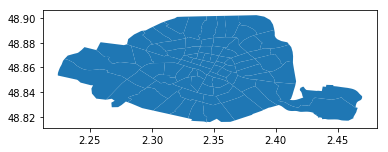

In [6]:
quar_bg_json = gpd.read_file('data/quartier_paris.geojson')

quar_bg_json.head(2)
quar_bg_json.shape
quar_list = quar_bg_json.l_qu.values
quar_bg_json.plot()

### Arrondissements de Paris

,n_sq_co,perimetre,objectid,l_ar,surface,longueur,n_sq_ar,l_aroff,c_arinsee,c_ar,geometry
0,750001537,6054.936862,1,1er Ardt,1.824613e+06,6054.680862,750000001,Louvre,75101,1,"POLYGON ((2.328007329038849 48.86991742140715,..."
1,750001537,4554.104360,2,2ème Ardt,9.911537e+05,4553.938764,750000002,Bourse,75102,2,"POLYGON ((2.351518483670821 48.8644258050741, ..."


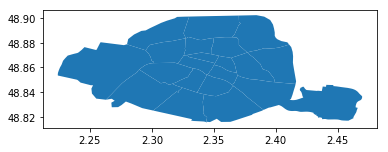

In [7]:
arr_bg_json = gpd.read_file('paris_bg_maps/arrondissements/arrondissements.geojson')
arr_bg_json = arr_bg_json.sort_values(by='c_arinsee').reset_index(drop=True)

arr_bg_json.head(2)
arr_bg_json = arr_bg_json.to_crs(epsg=4326)
arr_bg_json.plot()

# Mapping with folium

In [8]:
# This version of folium allows to produce time evolving cloropleth maps
folium.__version__

'0.5.0+145.gb7b31aa'

### Density map by year
The following functions produces a heatmap of airbnbs in a given year

In [9]:


def heatmap_year(df, date):
    
    df_temp = df[df.date_taken==date]
    
    airbnbArr = df_temp[['latitude', 'longitude']].as_matrix().tolist()



    hmap = folium.Map(location=[48.864716, 2.349014], zoom_start=12.3)

    hm_wide = HeatMap(airbnbArr, radius=12,
                 min_opacity=0.2,
                 max_val=250, 
                  blur=15, max_zoom=0)

    #folium.GeoJson(arr_bg_json).add_to(hmap)
    hmap.add_children(hm_wide)

    #color_map.caption = 'A colormap caption'

    return hmap


In [10]:
hmap_2013 = heatmap_year(df, '2013-11')
hmap_2013

In [11]:
hmap_2017_02 = heatmap_year(df, '2017-02')
hmap_2017_02

### Time evolution

In this section I produce a heatmap of airbnbs evolving in time from 2013 to 2017

In [12]:
def time_to_num(time_str):
    yr, mm  = map(int, time_str.split('-'))
    return 100*yr+ mm 

df['date_taken_int']=df.date_taken.apply(lambda line: time_to_num(line))

steps = np.sort(df.date_taken_int.unique())
dates = np.sort(df.date_taken.unique())


In [13]:

# Create weight column, using date
df['date_taken_int'] = df['date_taken_int'].astype(float)

# List comprehension to make out list of lists
heat_data = [[[row['latitude'],row['longitude']] \
              for index,row in df[df['date_taken_int'] == i].iterrows()]\
             for i in steps]



In [15]:
# Plot it on the map
map_time = folium.Map(location=[48.864716, 2.349014], zoom_start=12.4) 

hm = plugins.HeatMapWithTime(heat_data,auto_play=True,
                             max_opacity=0.8,
                             radius=2,
                             min_opacity=0.1,
                             #,
                            index = dates.tolist())
#                            scale_radius=True);
hm.add_to(map_time);
# Display the map
map_time

## Price and rating by arrondissement

Map every quartier to a number to match the map

In [16]:
neigh_df = quar_bg_json[['c_qu', 'l_qu']].reset_index(drop = True)
neigh_dict_temp = neigh_df.to_dict()
#neigh_dic#t
neigh_dict = {name:int(n) for n, name in \
              zip(neigh_dict_temp['c_qu'].values(), neigh_dict_temp['l_qu'].values())}

df = df.dropna(subset=['regular_neighborhood'])

df['regular_neighborhood_num']=df.regular_neighborhood.map(neigh_dict).astype(int)

In [17]:
type(df['regular_neighborhood_num'][1])

numpy.int64

### Group by date 

I build a datframe with mean and std of price, overall rating, location rating, divided by arrondissement and quartier

In [18]:

def make_agg_df(df, col, bg_arr, id_col):
    
    #df = df[df[df.date_taken==date]]
    
    # Mean price and std by arr
    myD = df.groupby([col])
    agg = pd.core.groupby.GroupBy.aggregate
    myD_av_price = myD['price'].agg(np.mean)
    myD_std_price = myD['price'].agg(np.std)

    # Mean evaluation 
    myD = df.groupby([col])
    agg = pd.core.groupby.GroupBy.aggregate
    myD_av_eval = myD['overall_satisfaction'].agg(np.mean)
    myD_std_eval = myD['overall_satisfaction'].agg(np.std)


    # Number of airbnbs

    myD = df.groupby([col])
    agg = pd.core.groupby.GroupBy.aggregate
    myD_count = myD['room_id'].agg('count')

    mean_std_df = pd.DataFrame({'arrondissement':myD_std_price.index,
                            'count': myD_count.values,
                            'price_mean':myD_av_price.values, 
                            'price_std':myD_std_price.values,
                            'overall_satisfaction_mean':myD_av_eval.values,
                           'overall_satisfaction_std':myD_std_eval.values})
    
    bg_arr = bg_arr[[id_col,'geometry']].sort_values(by=id_col).reset_index(drop=True)
    arr_bg_area = bg_arr.copy().to_crs({'init':'epsg:3857'})
    bg_arr.crs
    #arr_bg.shift(periods=1)
    crs = bg_arr.crs #{'init': 'epsg:4326','no_defs': True}
    
    geo_df_arr = gpd.GeoDataFrame(mean_std_df, crs=crs, geometry=bg_arr['geometry'])
    bg_arr['centroid'] = bg_arr['geometry'].centroid
    bg_arr['area']=arr_bg_area['geometry'].area/10**6
    geo_df_arr = pd.concat([geo_df_arr,bg_arr[['centroid','area']]], axis=1)
    geo_df_arr['density']=geo_df_arr['count']/geo_df_arr['area']

    return geo_df_arr

In [19]:
dates = np.sort(df.date_taken.unique()).tolist()
dates

['2013-11',
 '2014-05',
 '2014-09',
 '2014-12',
 '2015-02',
 '2015-12',
 '2016-05',
 '2016-08',
 '2017-01',
 '2017-02',
 '2017-03',
 '2017-04',
 '2017-06',
 '2017-07',
 '2018-06']

In [20]:
geo_df_all_arr = {date:make_agg_df(df[df.date_taken==date], 
                               'arrondissement_num', arr_bg_json, 'c_ar')\
                  for date in dates}

geo_df_all_quar = {date:make_agg_df(df[df.date_taken==date], 
                               'regular_neighborhood_num', quar_bg_json, 'c_qu')\
                  for date in dates}

### Cloropleth map

In this section I produce cloropleth maps of prices in different years

In [52]:
#help(folium.Map.choropleth)

In [21]:
import branca

from branca.utilities import split_six

colorscale = branca.colormap.linear.YlOrRd_09.scale(0, 50e3)


In [619]:
#help(districts.choropleth)

In [22]:

def make_cloropleth_quar(data, col, th):

    #threshold_scale = np.linspace(min(data[col]), max(data[col]),6).tolist()
    districts = folium.Map(location=[48.864716, 2.349014], zoom_start=12.4)
    districts.choropleth(geo_data=quar_bg_json, 
                         data=data,
                         columns=['arrondissement',col],
                         key_on='feature.properties.c_qu',
                         fill_color='OrRd', 
                        fill_opacity=0.65,
                        line_opacity=0.1,
                        legend_name=col,
                        threshold_scale=th)

    return districts


#### Prices in 2013

In [24]:
# set the bin edges to assign colors
my_threshold_scale_price = [30, 80, 100, 150, 270]

districts = make_cloropleth_quar(geo_df_all_quar['2013-11'], 
                                 'price_mean',
                                 my_threshold_scale_price)
districts

#### Prices in 2018

In [26]:
districts_18 = make_cloropleth_quar(geo_df_all_quar['2018-06'],
                                 'price_mean',
                                 my_threshold_scale_price)
districts_18

The prices seem to have lowered. Next, I'll try to visualize the trend in a time evolving map.

Note: the assigment color-price category is not clear. I couldn't figure it out from the docs, but I believe there is a bug in the plot legend.

### Cloropleth with time 

A recent branching of folium has a tool to make time evolving cloropleth maps: TimeSliderChoropleth.

Install the version of folium displayed at the beginning of this notebook to make it work.

In [45]:
def magnitude(x):
    return int(math.log10(x))

def round_next_int(x):
    if x==0:
        return 0
    else:
        return round(x/10**magnitude(x))*10**magnitude(x)

In [89]:
#help(pd.date_range)

In [46]:
n_periods = len(dates)

dt_index = pd.to_datetime(pd.DataFrame(dates, 
                                       columns=['Date'])['Date'],
                        format='%Y/%m')
dt_index = pd.Index(dt_index).strftime('%s')
dt_index

Index(['1383260400', '1398895200', '1409522400', '1417388400', '1422745200',
       '1448924400', '1462053600', '1470002400', '1483225200', '1485903600',
       '1488322800', '1490997600', '1496268000', '1498860000', '1527804000'],
      dtype='object')

In [55]:
th_scale_price_adj = [round_next_int(i) for i in my_threshold_scale_price]

th_scale_price_adj


[30, 80, 100, 200, 300]

In [56]:

my_color_scale = clist # ['palegreen','greenyellow', 'gold', 'firebrick','orange', 'chocolate']
 #clist
price_to_col_dict = {price:color for price, color \
                     in zip(th_scale_price_adj, my_color_scale)}

price_to_col_dict

{30: '#fef0d9', 80: '#fdd49e', 100: '#fdbb84', 200: '#fc8d59', 300: '#e34a33'}

In [57]:
for date in dates:
    geo_df_all_quar[date]['price_cat'] = pd.cut(geo_df_all_quar[date]['price_mean'],
                                                 bins=th_scale_price_adj+[500],
                                                labels=th_scale_price_adj)


geo_df_all_quar['2018-06'].iloc[75,:]['price_cat']
geo_df_all_quar['2018-06'].iloc[75,:]['price_mean']

30

73.199822380106568

In [58]:
styledata = {}

n_periods = len(dt_index)


for i,date in enumerate(dates):
    
    for row in geo_df_all_quar[date].iterrows():
    
        quar = row[1]['arrondissement']-1
        my_col = price_to_col_dict[row[1]['price_cat']]
    
        df_style = pd.DataFrame(
            {'color': my_col ,
             'opacity': 0.8,
            'mp': row[1]['price_mean'],
             'cat':row[1]['price_cat'],
            'q':row[1]['arrondissement'],
            'date':date},
            index = [dt_index[i]]
        )
    
        #df_style = df_style.cumsum()
        #df.sample(n_sample, replace=False).sort_index()
        try:
            styledata[quar].append(df_style)
        except KeyError:
            styledata[quar] = [df_style]

for quar in styledata.keys():
    styledata[quar] =  pd.concat(styledata[quar], axis=0)



In [59]:
# Example
styledata[74]

,color,opacity,mp,cat,q,date
1383260400,#fdbb84,0.8,117.898246,100,75,2013-11
1398895200,#fdbb84,0.8,130.860169,100,75,2014-05
1409522400,#fdbb84,0.8,117.863768,100,75,2014-09
1417388400,#fdbb84,0.8,117.507331,100,75,2014-12
1422745200,#fdbb84,0.8,114.747989,100,75,2015-02
1448924400,#fdd49e,0.8,84.238453,80,75,2015-12
1462053600,#fdd49e,0.8,82.153846,80,75,2016-05
1470002400,#fef0d9,0.8,78.163783,30,75,2016-08
1483225200,#fef0d9,0.8,75.256243,30,75,2017-01
1485903600,#fef0d9,0.8,75.501182,30,75,2017-02


In [60]:
styledict = {
    str(country): data[['color','opacity']].to_dict(orient='index') for
    country, data in styledata.items()
}


In [61]:

#m = folium.Map(location=[0, 0], zoom_start=2, tiles='Stamen Toner')
m = folium.Map(location=[48.864716, 2.349014], zoom_start=12.4)

g = TimeSliderChoropleth(
    quar_bg_json.to_json(),
    styledict=styledict,

).add_to(m)


#m.save(os.path.join('results', 'TimeSliderChoropleth.html'))

m

Problems:

- colors don't match values. I don't understand where the mismatch comes from, since then association value - quarter is correct (checked). 
- I don't manage to properly control the color scale 